# Quantifying the World
## Case Study 5
### Anish Bhandari

In [33]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [35]:
data = pd.read_csv("C:\\Users\\bhand\\OneDrive\\Desktop\\Quantifying the World\\Case Studies\\Case Study 5 -SVM and SGD\\log2.csv")

In [36]:
data.head(10)

,Source Port,Destination Port,NAT Source Port,NAT Destination Port,Action,Bytes,Bytes Sent,Bytes Received,Packets,Elapsed Time (sec),pkts_sent,pkts_received
0,57222,53,54587,53,allow,177,94,83,2,30,1,1
1,56258,3389,56258,3389,allow,4768,1600,3168,19,17,10,9
2,6881,50321,43265,50321,allow,238,118,120,2,1199,1,1
3,50553,3389,50553,3389,allow,3327,1438,1889,15,17,8,7
4,50002,443,45848,443,allow,25358,6778,18580,31,16,13,18
5,51465,443,39975,443,allow,3961,1595,2366,21,16,12,9
6,60513,47094,45469,47094,allow,320,140,180,6,7,3,3
7,50049,443,21285,443,allow,7912,3269,4643,23,96,12,11
8,52244,58774,2211,58774,allow,70,70,0,1,5,1,0
9,50627,443,16215,443,allow,8256,1674,6582,31,75,15,16


In [37]:
data.shape

(65532, 12)

In [38]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 65532 entries, 0 to 65531
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   Source Port           65532 non-null  int64 
 1   Destination Port      65532 non-null  int64 
 2   NAT Source Port       65532 non-null  int64 
 3   NAT Destination Port  65532 non-null  int64 
 4   Action                65532 non-null  object
 5   Bytes                 65532 non-null  int64 
 6   Bytes Sent            65532 non-null  int64 
 7   Bytes Received        65532 non-null  int64 
 8   Packets               65532 non-null  int64 
 9   Elapsed Time (sec)    65532 non-null  int64 
 10  pkts_sent             65532 non-null  int64 
 11  pkts_received         65532 non-null  int64 
dtypes: int64(11), object(1)
memory usage: 6.0+ MB


In [39]:
data.isnull().sum()

Source Port             0
Destination Port        0
NAT Source Port         0
NAT Destination Port    0
Action                  0
Bytes                   0
Bytes Sent              0
Bytes Received          0
Packets                 0
Elapsed Time (sec)      0
pkts_sent               0
pkts_received           0
dtype: int64

In [40]:
data.describe()

,Source Port,Destination Port,NAT Source Port,NAT Destination Port,Bytes,Bytes Sent,Bytes Received,Packets,Elapsed Time (sec),pkts_sent,pkts_received
count,65532.000000,65532.000000,65532.000000,65532.000000,6.553200e+04,6.553200e+04,6.553200e+04,6.553200e+04,65532.000000,65532.000000,65532.000000
mean,49391.969343,10577.385812,19282.972761,2671.049930,9.712395e+04,2.238580e+04,7.473815e+04,1.028660e+02,65.833577,41.399530,61.466505
std,15255.712537,18466.027039,21970.689669,9739.162278,5.618439e+06,3.828139e+06,2.463208e+06,5.133002e+03,302.461762,3218.871288,2223.332271
min,0.000000,0.000000,0.000000,0.000000,6.000000e+01,6.000000e+01,0.000000e+00,1.000000e+00,0.000000,1.000000,0.000000
25%,49183.000000,80.000000,0.000000,0.000000,6.600000e+01,6.600000e+01,0.000000e+00,1.000000e+00,0.000000,1.000000,0.000000
50%,53776.500000,445.000000,8820.500000,53.000000,1.680000e+02,9.000000e+01,7.900000e+01,2.000000e+00,15.000000,1.000000,1.000000
75%,58638.000000,15000.000000,38366.250000,443.000000,7.522500e+02,2.100000e+02,4.490000e+02,6.000000e+00,30.000000,3.000000,2.000000
max,65534.000000,65535.000000,65535.000000,65535.000000,1.269359e+09,9.484772e+08,3.208818e+08,1.036116e+06,10824.000000,747520.000000,327208.000000


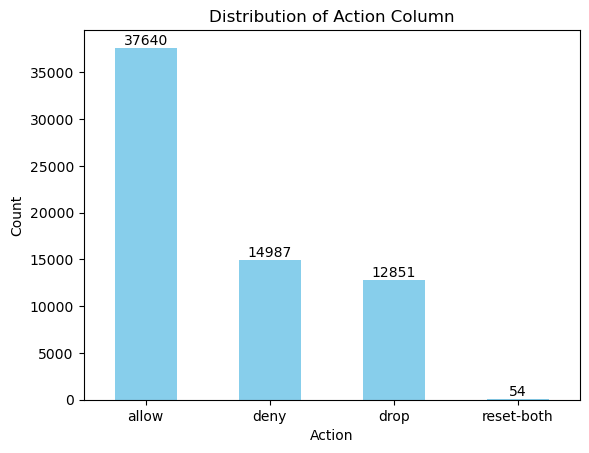

In [41]:

# Plot the distribution of the 'Action' column
action_counts = data['Action'].value_counts()


bars = action_counts.plot(kind='bar', color='skyblue')
plt.title("Distribution of Action Column")
plt.xlabel("Action")
plt.ylabel("Count")
plt.xticks(rotation=0)

bars.bar_label(bars.containers[0])

plt.show()



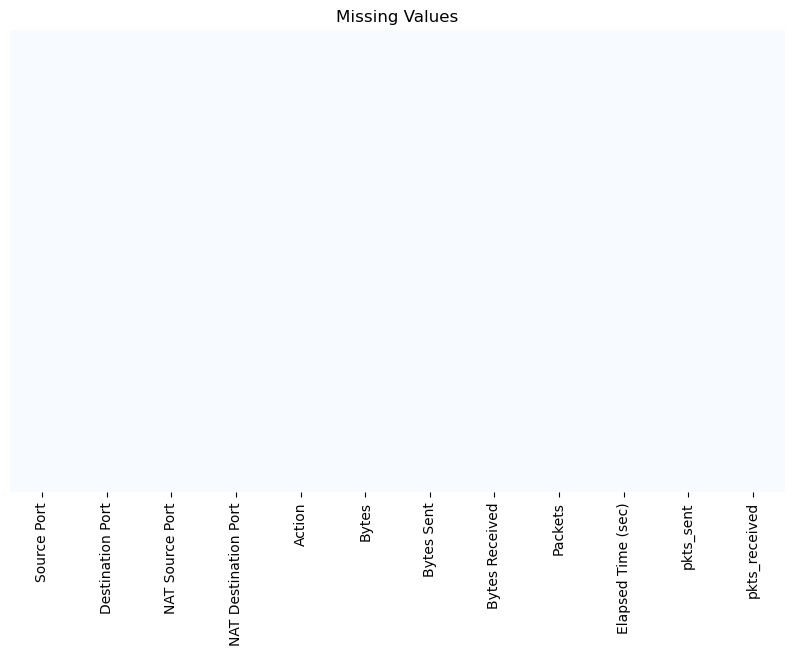

In [42]:
import seaborn as sns
import matplotlib.pyplot as plt


plt.figure(figsize=(10, 6))
sns.heatmap(data.isnull(), cbar=False, cmap='Blues', yticklabels=False)
plt.title("Missing Values")
plt.show()




In [43]:

(data['Destination Port'] == data['NAT Destination Port']).all()

False

In [44]:
data[data['Destination Port'] != data['NAT Destination Port']]

,Source Port,Destination Port,NAT Source Port,NAT Destination Port,Action,Bytes,Bytes Sent,Bytes Received,Packets,Elapsed Time (sec),pkts_sent,pkts_received
141,51048,445,0,0,drop,70,70,0,1,0,1,0
142,51045,445,0,0,drop,70,70,0,1,0,1,0
143,13394,23,0,0,deny,60,60,0,1,0,1,0
144,61078,57470,0,0,deny,62,62,0,1,0,1,0
145,55725,445,0,0,drop,70,70,0,1,0,1,0
146,55723,445,0,0,drop,70,70,0,1,0,1,0
147,55724,445,0,0,drop,70,70,0,1,0,1,0
148,51125,445,0,0,drop,66,66,0,1,0,1,0
149,51123,445,0,0,drop,66,66,0,1,0,1,0
150,51122,445,0,0,drop,66,66,0,1,0,1,0


In [45]:
# Convert port columns to categorical data types
port_columns = ['Source Port', 'Destination Port', 'NAT Source Port', 'NAT Destination Port']
data[port_columns] = data[port_columns].astype('category')


In [46]:
#  count of unique values in each port column

pd.set_option('display.max_rows', None)

data['Source Port'].value_counts()
    

Source Port
58638    840
27005    513
443      273
57470    222
49418    210
6881     177
0        173
50584    116
3478     105
26900    102
5588      87
42298     84
48817     82
45941     77
50265     75
16387     73
37965     72
45964     68
1024      67
6666      53
30960     53
11136     47
5223      46
80        46
48706     46
51221     46
49160     37
65189     36
45908     35
123       34
2267      33
57131     32
15503     32
19875     31
13285     30
44847     29
1025      28
6882      28
30188     28
57987     27
8889      27
40204     26
6889      26
50052     26
48676     25
25565     25
51414     25
8999      24
55877     24
54280     23
50116     23
10151     23
21133     22
50470     22
19473     22
47910     22
43584     22
27988     21
52459     20
51413     19
55056     19
17750     19
51880     19
993       19
6712      19
45682     19
49767     18
55600     18
49001     18
61550     17
55199     16
56624     16
5222      16
1027      16
51244     16
49708     16


In [19]:

data['Destination Port'].value_counts()

Destination Port
53       15414
445      12891
443      11684
80        4035
25174     1087
5900       909
37965      826
22114      767
64147      756
50584      717
57470      671
44847      626
35440      428
51505      375
26467      371
23         363
56205      288
30188      265
6881       239
27015      236
51221      206
15503      190
36237      186
11392      184
3389       176
0          173
21247      172
123        169
27017      161
37807      156
62413      144
48817      128
61463      122
22         119
50265      116
57866      108
5228       100
43890      100
7000        94
23117       89
5588        87
27016       86
1           85
15000       84
23718       71
5222        71
51413       69
36829       69
1433        66
51050       63
5223        63
39004       60
64097       57
31573       56
2767        56
23386       53
8999        52
17372       49
42707       49
40010       49
46824       48
42873       48
8080        44
23393       44
7302        42
27018   

In [20]:
data['NAT Source Port'].value_counts()

NAT Source Port
0        28432
48817       83
58638       51
50116       15
30399        5
14591        5
7986         5
57596        5
43757        5
60868        5
57880        5
11040        4
40711        4
9849         4
46008        4
9698         4
46343        4
1605         4
9497         4
28433        4
52506        4
59383        4
52438        4
19443        4
9177         4
52274        4
14752        4
5839         4
28391        4
45721        4
53473        4
15239        4
63151        4
34471        4
58294        4
10717        4
45042        4
38791        4
54503        4
30834        4
37247        4
17024        4
45580        4
28678        4
19722        4
40804        4
5232         4
53751        4
52040        4
19741        4
60967        4
7897         4
48756        4
50232        4
50193        4
24462        4
64744        4
64745        4
48945        4
49643        4
19874        4
60964        4
49234        4
49515        4
49502        4
49240    

In [21]:
data['NAT Destination Port'].value_counts()

NAT Destination Port
0        28432
53       15094
443      11678
80        4028
27015      234
27017      160
3389       156
123        156
6881       143
5228       100
7000        94
27016       86
15000       84
5222        71
51413       69
5223        58
5900        55
8999        52
40010       49
22          43
27018       42
993         38
8080        33
6889        31
3478        28
1024        24
8100        22
45682       20
27019       20
2710        19
1           18
50321       17
6882        17
23          16
8000        16
49152       16
6969        15
7275        15
20010       14
25          14
8060        13
28678       13
27025       12
66          12
1688        10
3544        10
16384        9
28080        9
16385        9
16386        9
40005        9
24874        8
36653        8
1025         8
7010         8
40002        8
27020        8
40031        8
47783        7
40022        7
49001        7
41599        7
27126        7
27013        7
27037        7
2700

In [47]:
df = data
data1 = data
data2=data

In [48]:
data1.head(10)

,Source Port,Destination Port,NAT Source Port,NAT Destination Port,Action,Bytes,Bytes Sent,Bytes Received,Packets,Elapsed Time (sec),pkts_sent,pkts_received
0,57222,53,54587,53,allow,177,94,83,2,30,1,1
1,56258,3389,56258,3389,allow,4768,1600,3168,19,17,10,9
2,6881,50321,43265,50321,allow,238,118,120,2,1199,1,1
3,50553,3389,50553,3389,allow,3327,1438,1889,15,17,8,7
4,50002,443,45848,443,allow,25358,6778,18580,31,16,13,18
5,51465,443,39975,443,allow,3961,1595,2366,21,16,12,9
6,60513,47094,45469,47094,allow,320,140,180,6,7,3,3
7,50049,443,21285,443,allow,7912,3269,4643,23,96,12,11
8,52244,58774,2211,58774,allow,70,70,0,1,5,1,0
9,50627,443,16215,443,allow,8256,1674,6582,31,75,15,16


In [24]:
data['Source Port'].info

<bound method Series.info of 0        57222
1        56258
2         6881
3        50553
4        50002
5        51465
6        60513
7        50049
8        52244
9        50627
10       43676
11       52190
12       50690
13       55597
14       49164
15       36887
16        1939
17       50281
18       57222
19       56710
20       48488
21       50691
22       50693
23        1940
24       50172
25       38802
26       50281
27       50051
28       52192
29       57886
30       50289
31       58615
32       38551
33       64787
34       34529
35       52184
36       60377
37       59347
38       50077
39       50149
40       50004
41       60411
42       60354
43       60399
44       60348
45       60420
46       60423
47       60360
48       60363
49        9523
50       63842
51       60430
52       59878
53       53179
54       60414
55       60400
56       60407
57       60398
58       60339
59       38641
60       54996
61       48066
62       60811
63       52103
64       52

In [49]:
df['Source Port'].nunique()

22724

In [50]:
df['Source Port'].unique()

[57222, 56258, 6881, 50553, 50002, ..., 61308, 30023, 53518, 36226, 54871]
Length: 22724
Categories (22724, int64): [0, 5, 20, 22, ..., 65531, 65532, 65533, 65534]

In [51]:
print((df['Source Port'].value_counts() < 10).sum())

22321


In [52]:
valuesp = df['Source Port'].value_counts()
valuesp.quantile(0.4)

1.0

In [53]:
valuenatsp = df['NAT Source Port'].value_counts()
valuenatsp.quantile(0.77)

2.0

In [54]:
valuedp = df['Destination Port'].value_counts()
valuedp.quantile(0.45)

1.0

In [55]:
valuenatdp = df['NAT Destination Port'].value_counts()
valuenatdp.quantile(0.7)

2.0

In [32]:
# classify rare source port with sigle occuring values

df['Source Port'] = df['Source Port'].where(df['Source Port'].map(df['Source Port'].value_counts()) > 1, 'rare_source_port')
df['Source Port'].nunique()


TypeError: Cannot setitem on a Categorical with a new category (rare_source_port), set the categories first

In [ ]:
# check
valuesp1 = df['Source Port'].value_counts()
valuesp1.quantile(0.05)

In [ ]:
# Now Destination Port
df['Destination Port'] = df['Destination Port'].where(df['Destination Port'].map(df['Destination Port'].value_counts()) > 1, 'rare_destination_port')


In [ ]:
# NAT Source Port
df['NAT Source Port'] = df['NAT Source Port'].where(df['NAT Source Port'].map(df['NAT Source Port'].value_counts()) > 1, 'rare_nat_source_port')


In [ ]:
# NAT Destination Port
df['NAT Destination Port'] = df['NAT Destination Port'].where(df['NAT Destination Port'].map(df['NAT Destination Port'].value_counts()) > 1, 'rare_nat_destination_port')


In [ ]:
# One-hot encoding

from sklearn.preprocessing import LabelEncoder

#  encode the 'Action' column
le = LabelEncoder()
df['Action'] = le.fit_transform(df['Action'])

# One-hot encode the port columns with 0 and 1 
coded_df = pd.get_dummies(df, columns=['Source Port', 'Destination Port', 'NAT Source Port', 'NAT Destination Port'], 
                          prefix=['Source_Port', 'Destination_Port', 'NAT_Source_Port', 'NAT_Destination_Port'], 
                          dtype=int)



coded_df.head()


In [ ]:
data.shape

In [ ]:
coded_df.shape

In [ ]:
# Reference for Action column
le.classes_

# SVM

In [98]:
from sklearn.model_selection import train_test_split


X = coded_df.drop('Action', axis=1)
y = coded_df['Action']

# Split the data into training and test sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=100)




Fitting 5 folds for each of 540 candidates, totalling 2700 fits


MemoryError: Unable to allocate 2.13 GiB for an array with shape (13623, 41940) and data type int32

In [101]:
import numpy as np
from sklearn.svm import SVC
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import classification_report, confusion_matrix
import pandas as pd

#  parameter grid with limited gamma values
param_dist = {
    'C': np.logspace(-3, 3, 10),  
    'gamma': ['scale', 'auto'],   
    'kernel': ['rbf']             
}

# SVM with RandomizedSearchCV
svm = SVC()
random_search = RandomizedSearchCV(
    svm, param_dist, n_iter=10, scoring='accuracy', cv=5, n_jobs=-1, random_state=100
)

# Fit model
random_search.fit(X_train, y_train)

# Best parameters and score
print("Best Parameters:", random_search.best_params_)
print("Best Cross-validation Score:", random_search.best_score_)

#  all scores for each parameter set
cv_results_df = pd.DataFrame(random_search.cv_results_)
cv_results_df = cv_results_df[['params', 'mean_test_score', 'std_test_score', 'rank_test_score']]
cv_results_df = cv_results_df.sort_values(by='rank_test_score')

# Show scores for each parameter set tested
print("All cross-validation scores:")
print(cv_results_df)

# Evaluate on test set
y_pred = random_search.best_estimator_.predict(X_test)
print("Classification Report:\n", classification_report(y_test, y_pred))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred))





MemoryError: Unable to allocate 2.13 GiB for an array with shape (13623, 41940) and data type int32

In [102]:
import numpy as np
from sklearn.svm import SVC
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import classification_report, confusion_matrix
from scipy.sparse import csr_matrix
import pandas as pd

#  matrices to sparse format
X_train_sparse = csr_matrix(X_train)
X_test_sparse = csr_matrix(X_test)

# Define parameter grid with balanced class weights
param_dist = {
    'C': np.logspace(-3, 3, 10),  
    'gamma': ['scale', 'auto'],   
    'kernel': ['rbf']            
}

#  SVM with class_weight='balanced' for imbalanced data handling
svm = SVC(class_weight='balanced')
random_search = RandomizedSearchCV(
    svm, param_dist, n_iter=10, scoring='accuracy', cv=5, n_jobs=-1, random_state=42
)

# Fit model with sparse matrices
random_search.fit(X_train_sparse, y_train)

# Best parameters and score
print("Best Parameters:", random_search.best_params_)
print("Best Cross-validation Score:", random_search.best_score_)

# all scores for each parameter set
cv_results_df = pd.DataFrame(random_search.cv_results_)
cv_results_df = cv_results_df[['params', 'mean_test_score', 'std_test_score', 'rank_test_score']]
cv_results_df = cv_results_df.sort_values(by='rank_test_score')

#  scores for each parameter set tested
print("All cross-validation scores:")
print(cv_results_df)

# Evaluate on test set
y_pred = random_search.best_estimator_.predict(X_test_sparse)
print("Classification Report:\n", classification_report(y_test, y_pred))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred))


Best Parameters: {'kernel': 'rbf', 'gamma': 'auto', 'C': 215.44346900318823}
Best Cross-validation Score: 0.9967191225560323
All cross-validation scores:
                                              params  mean_test_score  \
1  {'kernel': 'rbf', 'gamma': 'auto', 'C': 215.44...         0.996719   
2  {'kernel': 'rbf', 'gamma': 'auto', 'C': 46.415...         0.985618   
6  {'kernel': 'rbf', 'gamma': 'auto', 'C': 2.1544...         0.959161   
5  {'kernel': 'rbf', 'gamma': 'auto', 'C': 0.0215...         0.721068   
7  {'kernel': 'rbf', 'gamma': 'auto', 'C': 0.0046...         0.717787   
3     {'kernel': 'rbf', 'gamma': 'auto', 'C': 0.001}         0.715041   
8   {'kernel': 'rbf', 'gamma': 'scale', 'C': 1000.0}         0.405932   
9  {'kernel': 'rbf', 'gamma': 'scale', 'C': 215.4...         0.249175   
4  {'kernel': 'rbf', 'gamma': 'scale', 'C': 0.464...         0.243834   
0    {'kernel': 'rbf', 'gamma': 'scale', 'C': 0.001}         0.229185   

   std_test_score  rank_test_score  
1    

In [103]:
from sklearn.svm import SVC
from sklearn.metrics import classification_report, confusion_matrix

# SVM model with the best parameters
best_svm_model = SVC(kernel='rbf', gamma='auto', C=215.44346900318823)

# Fit the model on the training data
best_svm_model.fit(X_train, y_train)

# Predict on the test set
y_pred = best_svm_model.predict(X_test)


# classification report
print("Classification Report:")
print(classification_report(y_test, y_pred))

# confusion matrix
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))


Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      7544
           1       1.00      1.00      1.00      2972
           2       1.00      1.00      1.00      2584
           3       1.00      0.29      0.44         7

    accuracy                           1.00     13107
   macro avg       1.00      0.82      0.86     13107
weighted avg       1.00      1.00      1.00     13107

Confusion Matrix:
[[7542    2    0    0]
 [   2 2966    4    0]
 [   0    0 2584    0]
 [   0    5    0    2]]


# SGD

In [ ]:
from sklearn.linear_model import SGDClassifier
from sklearn.model_selection import RandomizedSearchCV
import numpy as np

# Parameter grid for SGD
param_grid = {
    'loss': ['hinge', 'log', 'modified_huber', 'squared_hinge'],
    'alpha': np.logspace(-4, 1, 10),
    'learning_rate': ['constant', 'optimal', 'invscaling', 'adaptive'],
    'penalty': ['l2', 'l1', 'elasticnet'],
    'max_iter': [1000],
    'early_stopping': [True]
}

#  SGD model
sgd = SGDClassifier()

# Randomized Search with cross-validation
random_search = RandomizedSearchCV(sgd, param_distributions=param_grid, n_iter=50, cv=5, scoring='accuracy', random_state=42)
random_search.fit(X_train, y_train)


print("Best Parameters:", random_search.best_params_)
print("Best Cross-validation Score:", random_search.best_score_)
